In [2]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.image import imread

In [3]:
# Helper Functions
def to_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

def downscale(image, scale_factor):
    new_width = int(image.shape[1] * scale_factor)
    new_height = int(image.shape[0] * scale_factor)
    return cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_NEAREST)

def display(img):
    fig, axs = plt.subplots(1, 1, figsize=(6, 6))
    axs.imshow(img)
    axs.axis('off')
    plt.tight_layout()
    plt.show()

def display_two(images):
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    for ax, img in zip(axs, images):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

def display_four(images):
    display_two(images[:2])
    display_two(images[2:])

In [5]:
from scipy.ndimage import uniform_filter

def kuwahara_filter_single_channel(img, window_size):
    print("Running kh filter single channel")
    if window_size % 2 == 0:
        raise ValueError("Window size must be odd.")

    radius = window_size // 2 + 1
    subregion_diff = radius // 2
    padding = radius - 1
    rows, cols = img.shape[:2]
    pad_width = ((padding, padding), (padding, padding))
    padded = np.pad(img, pad_width, mode='reflect')
    
    result = np.zeros_like(padded)

    means = uniform_filter(padded, size=radius+1, mode='constant', cval=0.0)
    sqr_means = uniform_filter(padded**2, size=radius+1, mode='constant', cval=0.0)
    variances = sqr_means - means**2

    offsets = np.array([(subregion_diff, subregion_diff), 
                        (-subregion_diff, subregion_diff), 
                        (subregion_diff, -subregion_diff), 
                        (-subregion_diff, -subregion_diff)])

    for r in range(padding, rows):
        for c in range(padding, cols):
            subregion_variances = variances[r + offsets[:, 0], c + offsets[:, 1]]
            min_index = np.argmin(subregion_variances)
            min_offset = offsets[min_index]
            result[r, c] = means[r + min_offset[0], c + min_offset[1]]  
    
    return result[padding:-padding, padding:-padding].astype(np.uint8)

def kuwahara_filter_rgb(img, window_size):
    if img.ndim != 3 or img.shape[2] != 3:
        raise ValueError("Input must be an RGB image")
    
    result = np.zeros_like(img)
    for i in range(3):  # Process each channel
        result[:,:,i] = kuwahara_filter_single_channel(img[:,:,i], window_size)
    
    return result.astype(np.uint8)

In [4]:
def canny(img, low_threshold, high_threshold, aperture_size=3, convert_grayscale = False):
    """
    Perform Canny edge detection.
    
    Parameters:
    - img: Input image (grayscale or color)
    - low_threshold: Lower threshold for edge linking
    - high_threshold: Higher threshold for edge linking
    - aperture_size: Aperture size for the Sobel operator
    
    Returns:
    - Binary edge map
    """
    if convert_grayscale:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(img, low_threshold, high_threshold, apertureSize=aperture_size)
    return edges

In [5]:
def sobel(img, ksize=3, scale=1, delta=0, dx=1, dy=1, convert_grayscale=False):
    """
    Perform Sobel edge detection.
    
    Parameters:
    - img: Input image (grayscale or color)
    - ksize: Kernel size for Sobel operator
    - scale: Scale factor for computed derivative values
    - delta: Value added to the result
    - dx: Order of derivative x
    - dy: Order of derivative y
    
    Returns:
    - Edge magnitude image
    """
    if convert_grayscale:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(img, cv2.CV_64F, dx, 0, ksize=ksize, scale=scale, delta=delta)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, dy, ksize=ksize, scale=scale, delta=delta)
    edges = np.sqrt(sobelx**2 + sobely**2)
    edges = cv2.normalize(edges, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
    return edges

In [8]:
def enhance_edges(binary_edges, kernel_size=3):
    # Apply morphological operations to clean up edges
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    enhanced_edges = cv2.morphologyEx(binary_edges, cv2.MORPH_CLOSE, kernel)
    enhanced_edges = cv2.morphologyEx(enhanced_edges, cv2.MORPH_OPEN, kernel)
    return enhanced_edgess

In [9]:
def merge_images(images):    
    # Ensure all images have the same size
    heights = [img.shape[0] for img in images]
    widths = [img.shape[1] for img in images]
    min_height = min(heights)
    min_width = min(widths)
    
    # Resize images if necessary
    resized_images = [cv2.resize(img, (min_width, min_height)) for img in images]
    
    # Merge images by taking the average
    merged = np.mean(resized_images, axis=0).astype(np.uint8)
    
    return merged

In [10]:
def merge_max_intensity(*images):
    """
    Merge multiple single-channel images by taking the maximum intensity for each pixel.
    
    Parameters:
    images : list of numpy.ndarray
        List of single-channel (grayscale) images to be merged.
        All images should have the same dimensions.
    
    Returns:
    numpy.ndarray
        A single-channel image where each pixel is the maximum intensity
        from all input images at that position.
    """
    if not images:
        raise ValueError("The list of images is empty.")
    
    if not all(img.shape == images[0].shape for img in images):
        raise ValueError("All images must have the same dimensions.")
    
    if not all(len(img.shape) == 2 for img in images):
        raise ValueError("All images must be single-channel (grayscale).")
    
    stacked = np.stack(images, axis=-1)
    merged = np.max(stacked, axis=-1)
    merged = merged.astype(np.uint8)
    
    return merged

In [11]:
def k_means(img, k):
    pixels = img.reshape((-1, 3)).astype(np.float32)
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 5, 0.2)
    _, labels, centers = cv2.kmeans(pixels, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    centers = np.uint8(centers)
    labels = labels.flatten()
    label_image = labels.reshape(img.shape[:2])
    segmented_image = centers[labels].reshape(img.shape)
    return segmented_image

In [3]:
def spatial_k_means(img, k, alpha=0.5, max_iter=10):
    height, width = img.shape[:2]
    
    # Create a 5D feature vector: [x, y, R, G, B]
    x = np.arange(width)
    y = np.arange(height)
    X, Y = np.meshgrid(x, y)
    
    # Normalize spatial coordinates to [0, 1]
    X = X / width
    Y = Y / height
    
    # Combine spatial and color features
    pixels = np.dstack((X, Y, img / 255.0)).reshape((-1, 5)).astype(np.float32)
    
    # Initialize centroids randomly
    centroids = pixels[np.random.choice(pixels.shape[0], k, replace=False)]
    
    for _ in range(max_iter):
        # Compute distances to centroids
        distances = np.sum((pixels[:, np.newaxis] - centroids) ** 2, axis=2)
        
        # Apply spatial weighting
        distances[:, :2] *= alpha
        distances[:, 2:] *= (1 - alpha)
        
        # Assign pixels to nearest centroid
        labels = np.argmin(distances, axis=1)
        
        # Update centroids
        new_centroids = np.array([pixels[labels == i].mean(axis=0) for i in range(k)])
        
        # Check for convergence
        if np.all(np.abs(new_centroids - centroids) < 1e-5):
            break
        
        centroids = new_centroids
    
    # Create segmented image
    segmented = centroids[labels]
    segmented_image = (segmented[:, 2:] * 255).reshape(img.shape).astype(np.uint8)
    
    return segmented_image, labels.reshape(height, width)

# Usage
def apply_spatial_k_means(img, k, alpha=0.5):
    segmented_image, label_image = spatial_k_means(img, k, alpha)
    return segmented_image, label_image

In [ ]:
yak = imread('./highland-cattle-8183107_640.jpg')
spatial_k_means(yak, 10)

In [13]:
beauty = imread('./thin-sections/w15/w15_beauty.jpg')
comp = imread('./thin-sections/w15/w15_composite.jpg')
lin = imread('./thin-sections/w15/w15_lin.jpg')
texture = imread('./thin-sections/w15/w15_texture.jpg')

In [18]:
# Pre-Processing: Spatial k-means
beauty_compressed = spatial_k_means(beauty, 10)
comp_compressed = spatial_k_means(comp, 10)

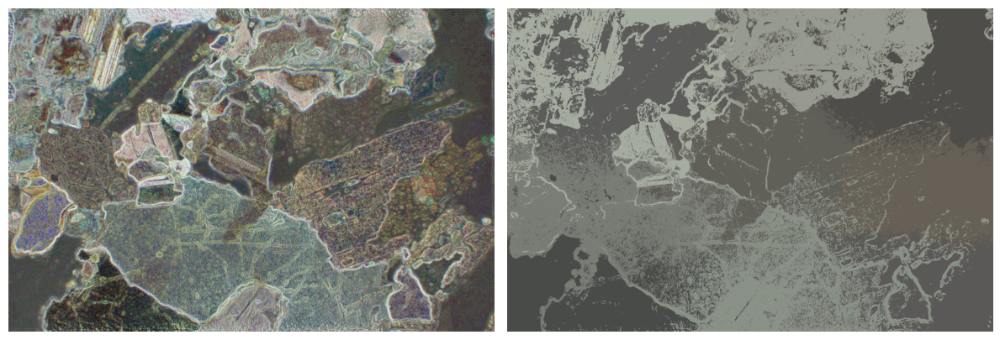

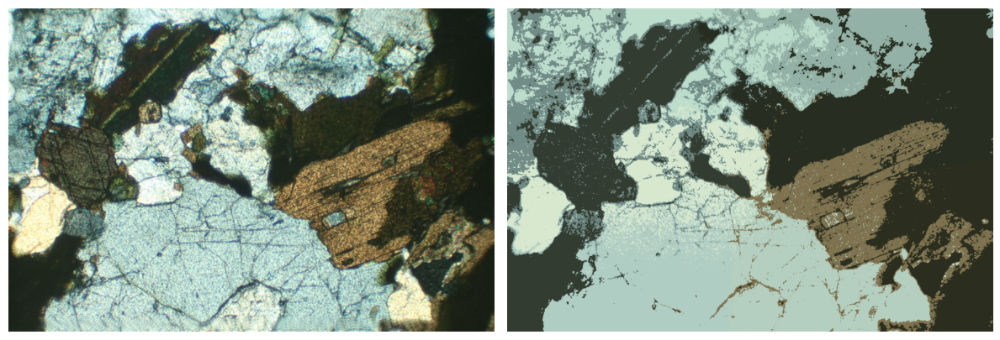

In [19]:
display_four([beauty, beauty_compressed[0], comp, comp_compressed[0]])

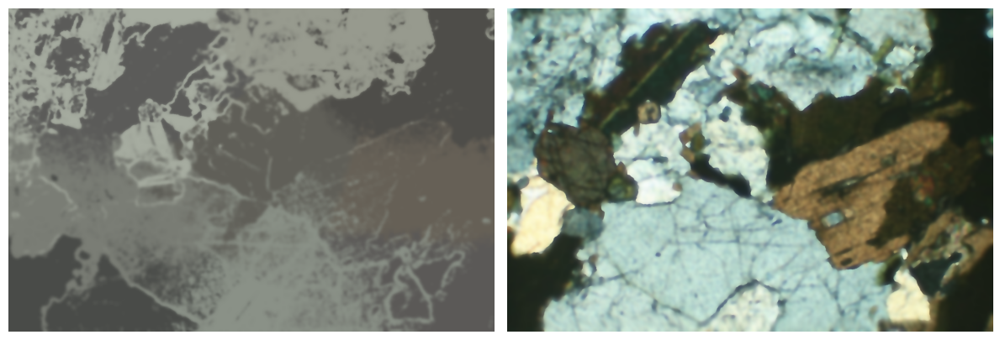

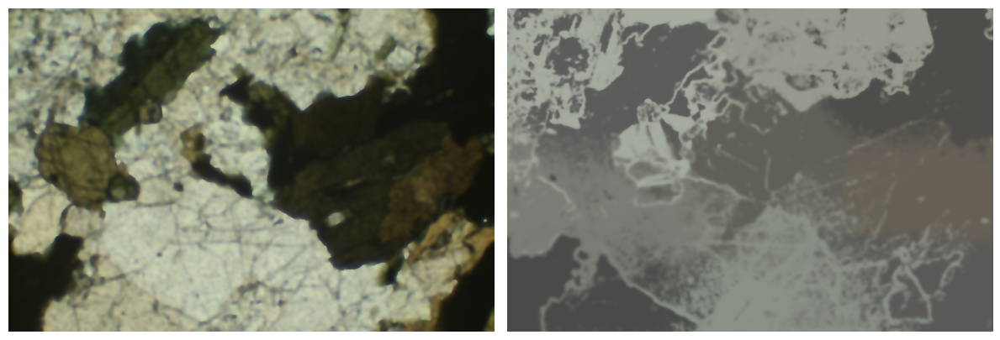

In [20]:
n1 = 20
n2 = 100
n3 = 50

# Use compressed beauty for testing
beauty = beauty_compressed[0]

# Bilateral Filtering
beauty_bl = cv2.bilateralFilter(beauty, n1, n2, n3)
comp_bl = cv2.bilateralFilter(comp, n1, n2, n3)
lin_bl = cv2.bilateralFilter(lin, n1, n2, n3)
texture_bl = cv2.bilateralFilter(texture, n1, n2, n3)

# Recursively apply the filter
# First recursive application
beauty_bl_r1 = cv2.bilateralFilter(beauty_bl, n1, n2, n3)
comp_bl_r1 = cv2.bilateralFilter(comp_bl, n1, n2, n3)
lin_bl_r1 = cv2.bilateralFilter(lin_bl, n1, n2, n3)
texture_bl_r1 = cv2.bilateralFilter(texture_bl, n1, n2, n3)

# Second recursive application
beauty_bl_r2 = cv2.bilateralFilter(beauty_bl_r1, n1, n2, n3)
comp_bl_r2 = cv2.bilateralFilter(comp_bl_r1, n1, n2, n3)
lin_bl_r2 = cv2.bilateralFilter(lin_bl_r1, n1, n2, n3)
texture_bl_r2 = cv2.bilateralFilter(texture_bl_r1, n1, n2, n3)


# Second recursive application
beauty_bl_r3 = cv2.bilateralFilter(beauty_bl_r2, n1, n2, n3)
comp_bl_r3 = cv2.bilateralFilter(comp_bl_r2, n1, n2, n3)
lin_bl_r3 = cv2.bilateralFilter(lin_bl_r2, n1, n2, n3)
texture_bl_r3 = cv2.bilateralFilter(texture_bl_r2, n1, n2, n3)

display_four([beauty_bl_r3, comp_bl_r3, lin_bl_r3, beauty_bl_r3])
# display_four([beauty, comp, lin, texture])

# merged = merge_images([beauty_bl_r3, comp_bl_r3, lin_bl_r3])
# display(merged)

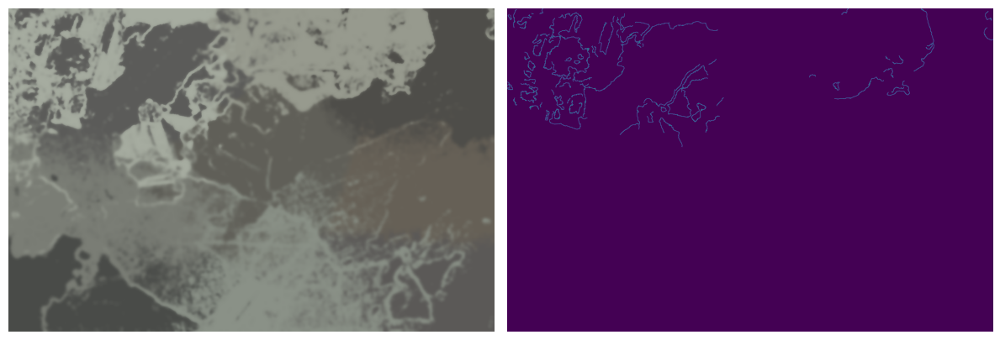

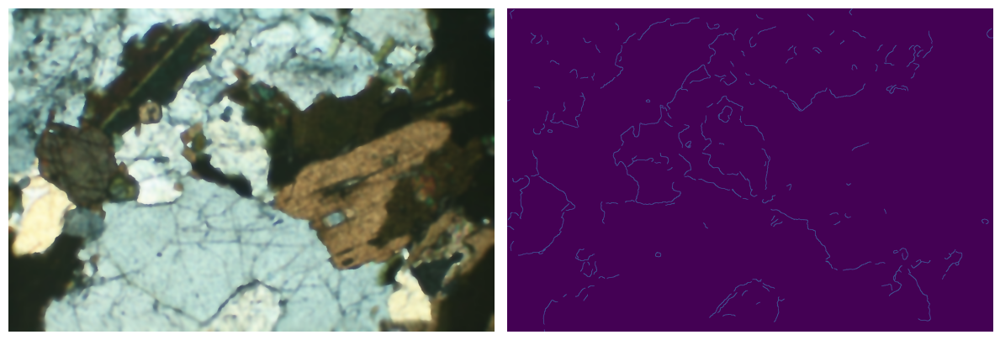

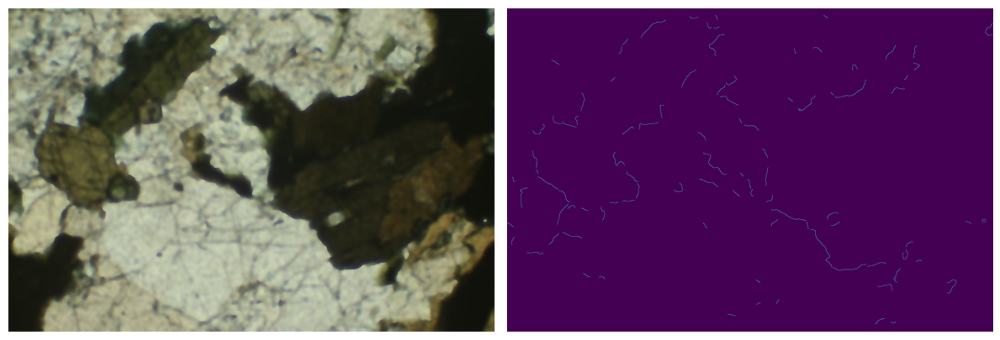

In [21]:
beauty = beauty_bl_r3
comp = comp_bl_r3
lin = lin_bl_r3

# Apply edge detection to individual images
lower = 25
upper = 150

beauty_canny = canny(beauty, lower, upper, 3)
comp_canny = canny(comp, lower, upper, 3)
lin_canny = canny(lin, lower, upper, 3)

display_two([beauty, beauty_canny])
display_two([comp, comp_canny])
display_two([lin, lin_canny])

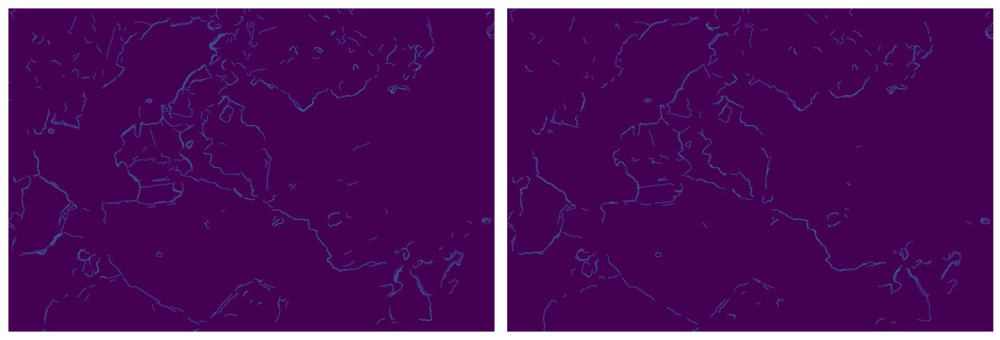

In [162]:
merged_edges_2 = merge_max_intensity(beauty_canny, comp_canny, lin_canny)
display_two([merged_edges, merged_edges_2])

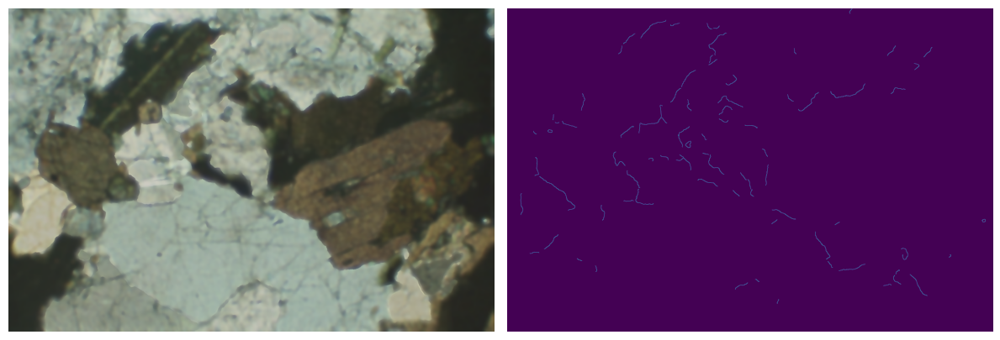

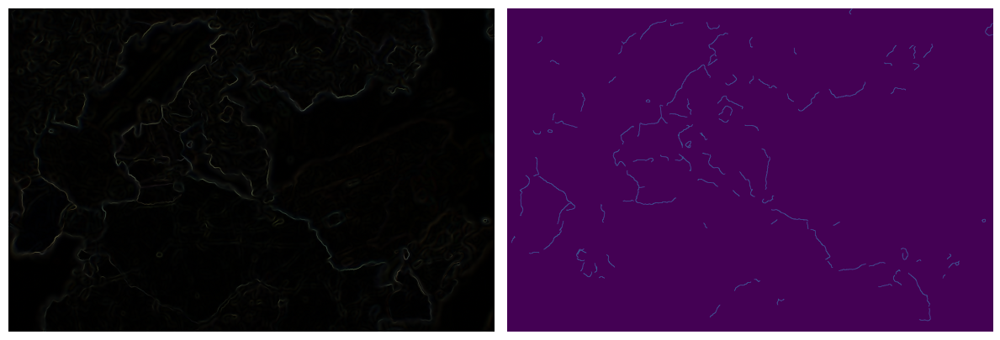

In [25]:
canny_high_thresh = canny(merged, 50, 200) # Default value of aperture = 3 works better
canny_low_thresh = canny(merged, 25, 150)
sobel_default = sobel(merged)

display_four([merged, canny_high_thresh, sobel_default, canny_low_thresh])


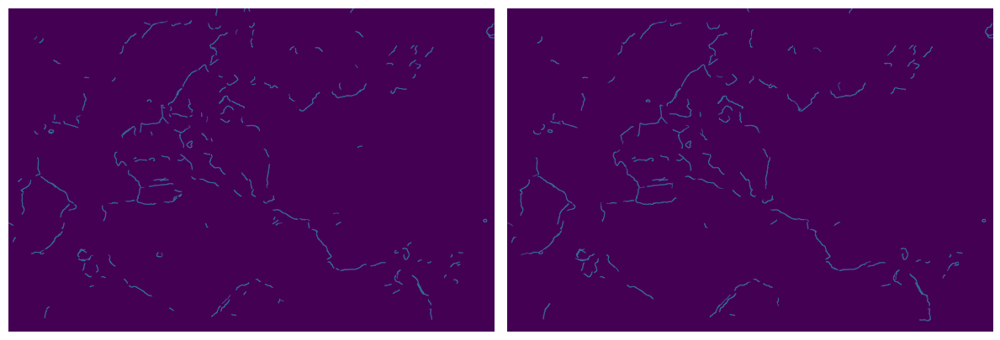

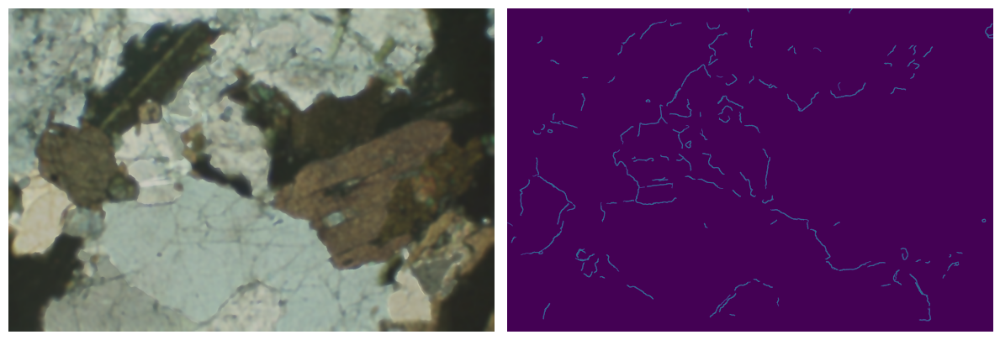

In [26]:
sobel_canny_high_thresh = canny(sobel_default, 50, 200)
sobel_canny_low_thresh = canny(sobel_default, 25, 250)

display_two([sobel_canny_high_thresh, sobel_canny_low_thresh])
display_two([merged, sobel_canny_low_thresh])

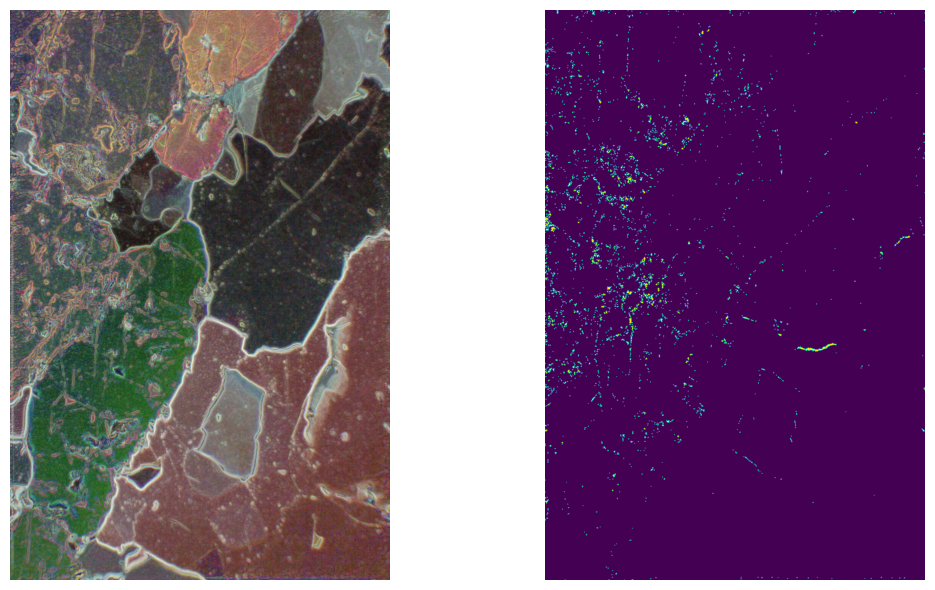

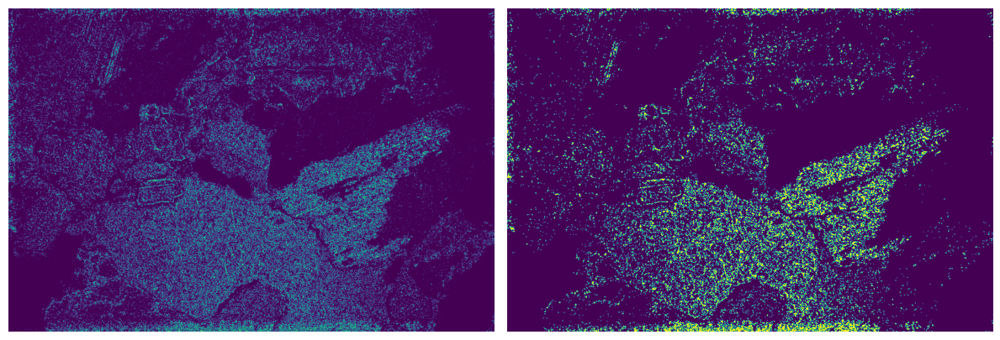

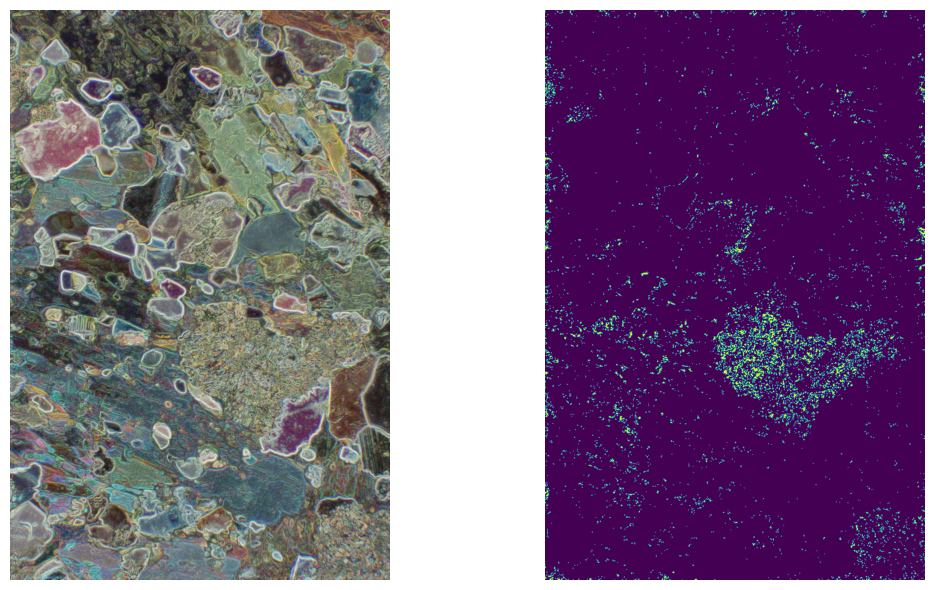

In [109]:
img_8a = imread('./thin-sections/8a/8a_beauty.jpg')
img_w15 = imread('./thin-sections/w15/w15_beauty.jpg')
img_9b_1 = imread('./thin-sections/9b_1/9b_1_beauty.jpg')

# edges_8a = detect_edges('./thin-sections/8a/8a_beauty.jpg')
# edges_w15 = detect_edges('./thin-sections/w15/w15_beauty.jpg')
# edges_9b_1 = detect_edges('./thin-sections/9b_1/9b_1_beauty.jpg')

# edges_8a = detect_edges('./thin-sections/8a/8a_beauty.jpg', 'sobel')
# edges_w15 = detect_edges('./thin-sections/w15/w15_beauty.jpg', 'sobel')
# edges_9b_1 = detect_edges('./thin-sections/9b_1/9b_1_beauty.jpg', 'sobel')

edges_8a = detect_edges('./thin-sections/8a/8a_beauty.jpg', 'log')
edges_w15 = detect_edges('./thin-sections/w15/w15_beauty.jpg', 'log')
edges_9b_1 = detect_edges('./thin-sections/9b_1/9b_1_beauty.jpg', 'log')

enhanced_8a = enhance_edges(edges_8a)
enhanced_w15 = enhance_edges(edges_w15)
enhanced_9b_1 = enhance_edges(edges_9b_1)

display_two([img_8a, enhanced_8a])
display_two([edges_w15, enhanced_w15])
display_two([img_9b_1, enhanced_9b_1])

In [44]:
def kmeans(image, k, max_iter=10, epsilon=0.2):

    pixel_values = image.reshape((-1, 3))
    pixel_values = np.float32(pixel_values)

    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, max_iter, epsilon)
    _, labels, centers = cv2.kmeans(pixel_values, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    centers = np.uint8(centers)
    segmented_image = centers[labels.flatten()]
    segmented_image = segmented_image.reshape(image.shape)

    return segmented_image

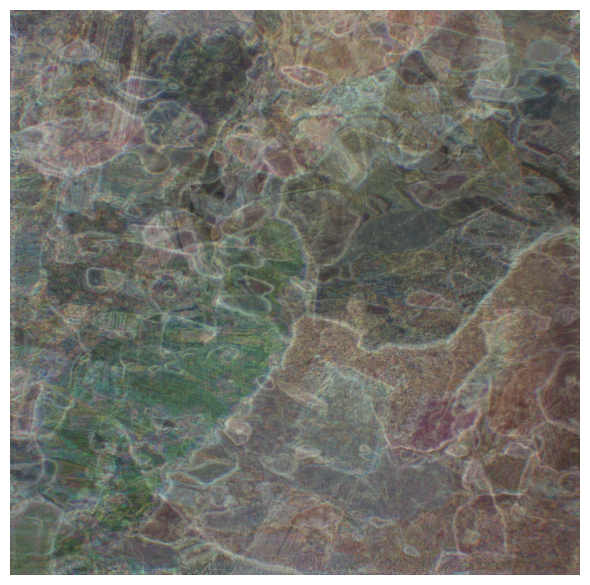

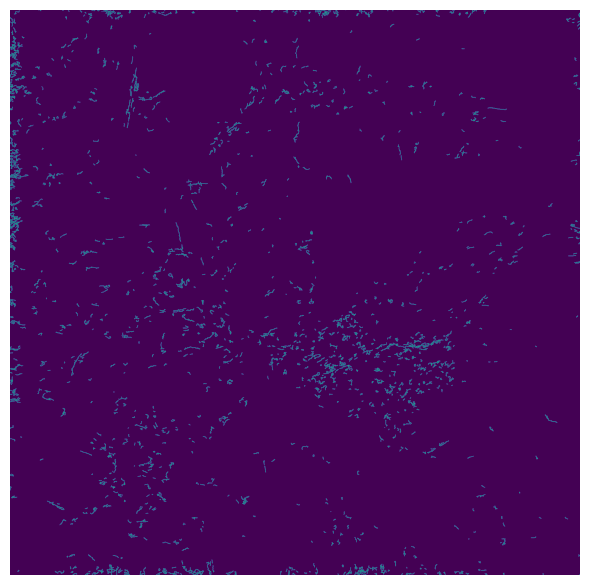

In [118]:
img_8a = imread('./thin-sections/8a/8a_beauty.jpg')
img_w15 = imread('./thin-sections/w15/w15_beauty.jpg')
img_9b = imread('./thin-sections/9b_1/9b_1_beauty.jpg')

# Merging seems to muddle the data a little too much
merged = merge_images([img_8a, img_w15, img_9b])
display(merged)

edges_canny = detect_edges(merged)
display(edges_canny)

In [50]:
def count_colors(img):    
    pixels = img.reshape(-1, 3)
    unique_colors = np.unique(pixels, axis=0)
    return len(unique_colors)

In [65]:
# Load images to play around with
img_8a = imread('./thin-sections/8a/8a_beauty.jpg')
img_w15 = imread('./thin-sections/w15/w15_beauty.jpg')
img_9b_1 = imread('./thin-sections/9b_1/9b_1_beauty.jpg')
img_9b_2 = imread('./thin-sections/9b_1/9b_1_beauty.jpg')

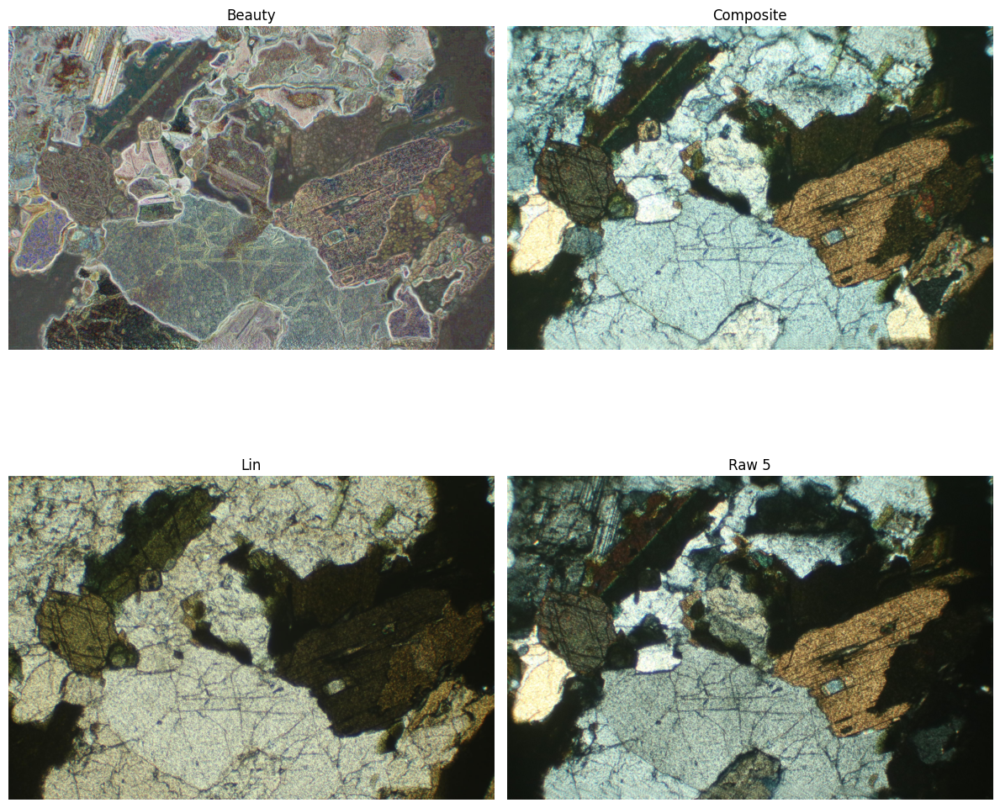

In [67]:
# Load wide thin section sample
w15_beauty = imread('./thin-sections/w15/w15_beauty.jpg')
w15_composite = imread('./thin-sections/w15/w15_composite.jpg')
w15_lin = imread('./thin-sections/w15/w15_lin.jpg')
w15_raw_5 = imread('./thin-sections/w15/w15_aligned_IMG_0005.JPG')

images = [w15_beauty, w15_composite, w15_lin, w15_raw_5]
titles = ['Beauty', 'Composite', 'Lin', 'Raw 5']

display_four(images, titles)

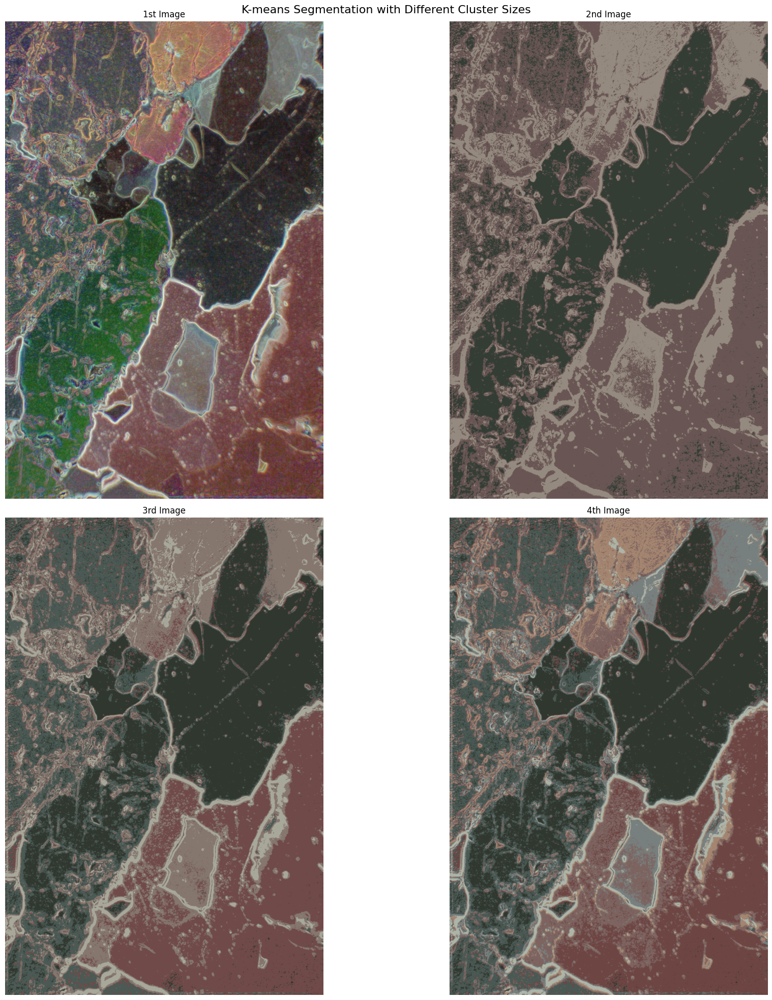

In [49]:
# Apply k-means with different cluster sizes
segmented_8a_3 = kmeans(img_8a, 3, 10)
segmented_8a_5 = kmeans(img_8a, 5, 10)
segmented_8a_7 = kmeans(img_8a, 7, 10)

display_four(img_8a, segmented_8a_3, segmented_8a_5, segmented_8a_7, 'K-means Segmentation with Different Cluster Sizes')

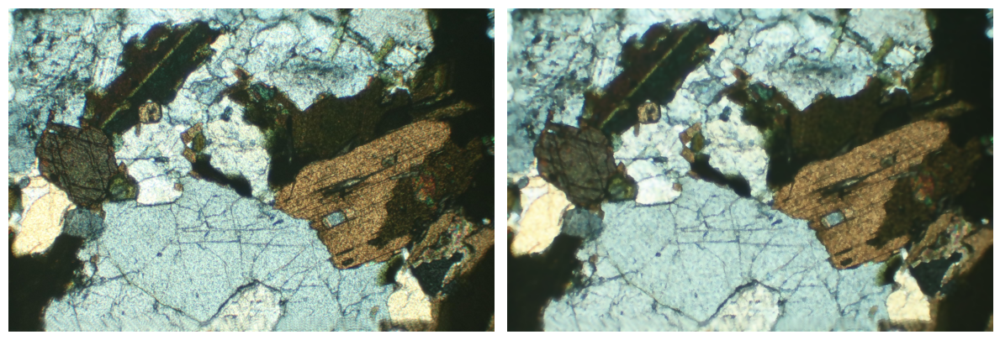

In [46]:
w15_composite_gaussians = [cv2.GaussianBlur(w15_composite, (ksize, ksize), 0) for ksize in [1, 5, 9, 13]]
w15_composite_median = cv2.medianBlur(w15_composite, 25)
w15_composite_bilateral = cv2.bilateralFilter(w15_composite, 25, 75, 75)

#display_four(w15_composite_gaussians)
display_two([w15_composite, w15_composite_bilateral])

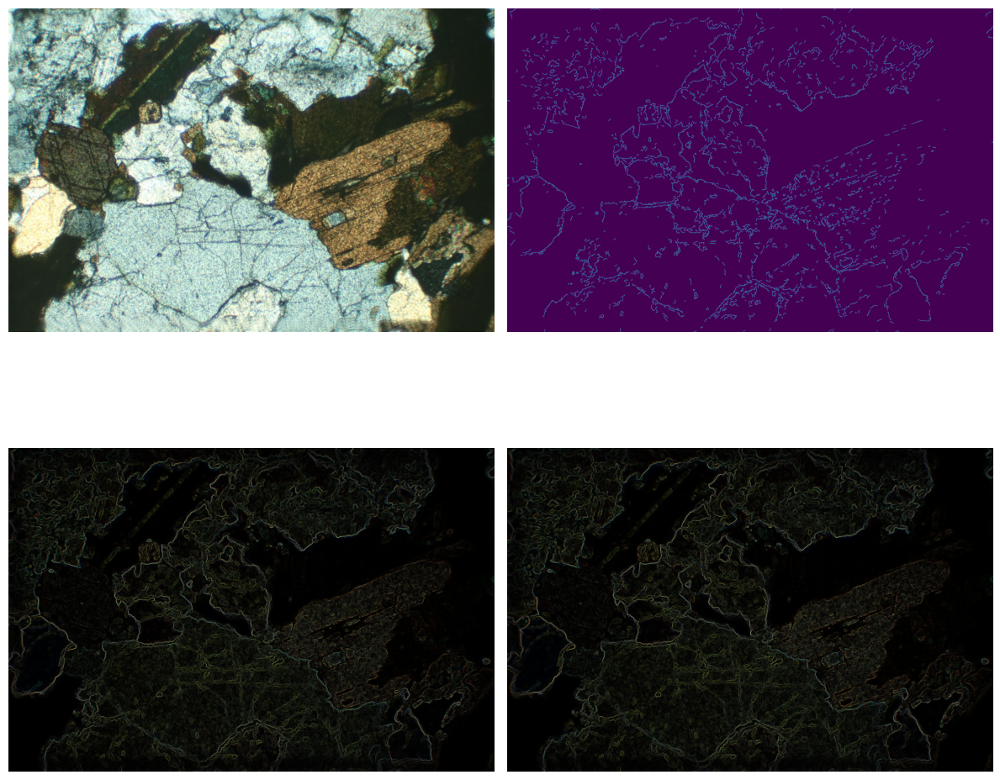

8


In [51]:
# Edge detection algorithms all do a much better job after blurring

w15_canny = cv2.Canny(w15_composite_bilateral, 100, 200)

sobel_x = cv2.Sobel(w15_composite_bilateral, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(w15_composite_bilateral, cv2.CV_64F, 0, 1, ksize=3)
sobel = np.hypot(sobel_x, sobel_y)
sobel = np.uint8(sobel / sobel.max() * 255)

display_four([w15_composite, w15_canny, sobel, sobel])
print(count_colors(w15_canny))

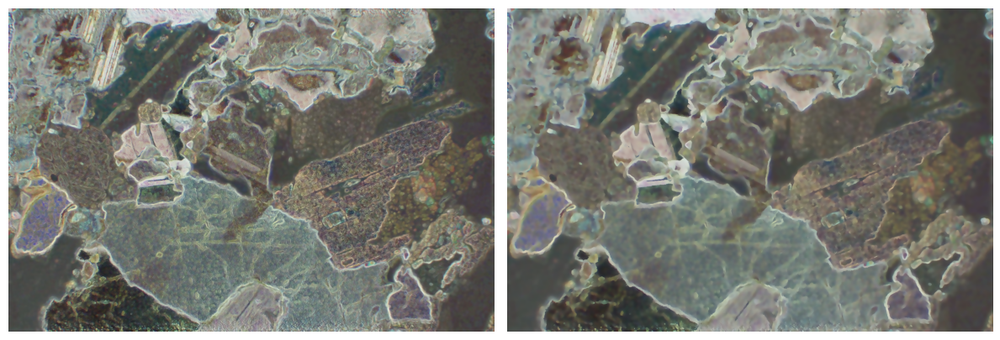

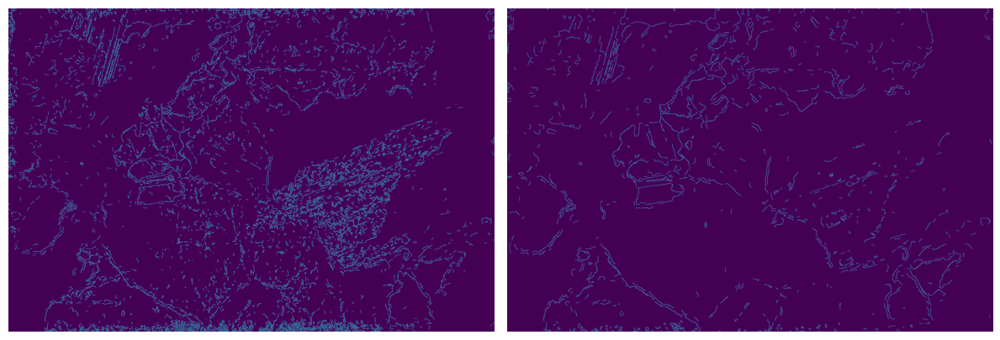

In [125]:
# Bilateral Filtering
# composite_bl = cv2.bilateralFilter(w15_composite, 25, 75, 75)
# beauty_bl = cv2.bilateralFilter(w15_beauty, 20, 20, 20)
beauty_bl2 = cv2.bilateralFilter(w15_beauty, 20, 50, 20)
# beauty_bl3 = cv2.bilateralFilter(w15_beauty, 20, 20, 50)
# beauty_bl4 = cv2.bilateralFilter(w15_beauty, 20, 50, 50)

# Recursively apply the filter
beauty_bl2_r1 = cv2.bilateralFilter(beauty_bl2, 20, 50, 20)
beauty_bl2_r2 = cv2.bilateralFilter(beauty_bl2_r1, 20, 50, 20)

#display(w15_beauty)
#display_four([beauty_bl, beauty_bl2, beauty_bl3, beauty_bl4])
display_two([beauty_bl2, beauty_bl2_r2])
edges_bl2_r2 = detect_edges(beauty_bl2_r2)
edges_bl2 = detect_edges(beauty_bl2)
display_two([edges_bl2, edges_bl2_r2])

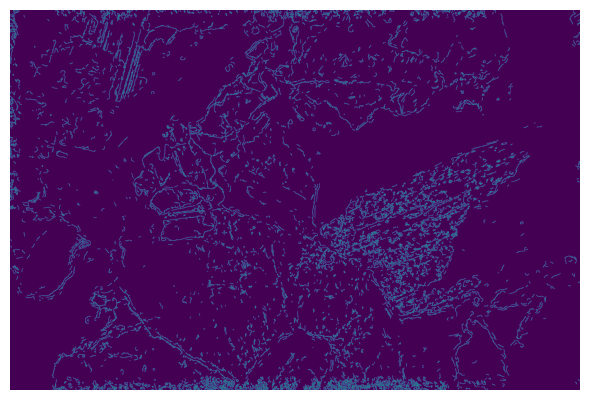

In [85]:
# Post Bilateral Filtering, edge detection algorithms
canny = cv2.Canny(beauty_bl2, 100, 200)
display(canny)


K-means Output:
Labels shape: (5904384, 1)
Centers shape: (3, 3)

Labels (first 10 elements):
[2 2 2 2 2 2 2 2 2 2]

Centers (RGB values for each cluster):
Cluster 0: RGB(np.int64(120), np.int64(122), np.int64(114))
Cluster 1: RGB(np.int64(78), np.int64(77), np.int64(74))
Cluster 2: RGB(np.int64(168), np.int64(174), np.int64(160))


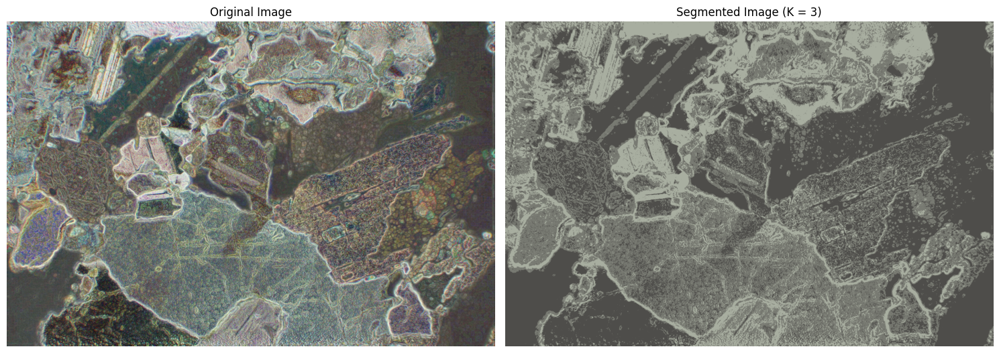

In [32]:
# Experimentation


img_8a = imread('./thin-sections/8a/8a_beauty.jpg')
img_w15 = imread('./thin-sections/w15/w15_beauty.jpg')
img_9b_1 = imread('./thin-sections/9b_1/9b_1_beauty.jpg')
img_9b_2 = imread('./thin-sections/9b_1/9b_1_beauty.jpg')

# K Means

image = img_w15

k = 3
max_iter = 100

pixel_values = image.reshape((-1, 3))
pixel_values = np.float32(pixel_values)

# Define criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, max_iter, 0.2)

# Apply k-means
_, labels, centers = cv2.kmeans(pixel_values, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

# Debug print statement
print("\nK-means Output:")
print(f"Labels shape: {labels.shape}")
print(f"Centers shape: {centers.shape}")
print("\nLabels (first 10 elements):")
print(labels.flatten()[:10])
print("\nCenters (RGB values for each cluster):")
for i, center in enumerate(centers):
    print(f"Cluster {i}: RGB{tuple(center.astype(int))}")

centers = np.uint8(centers)

# Create segmented image
segmented_image = centers[labels.flatten()]
segmented_image = segmented_image.reshape(image.shape)

# Display results
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 7))

ax1.imshow(image)
ax1.set_title('Original Image')
ax1.axis('off')

ax2.imshow(segmented_image)
ax2.set_title(f'Segmented Image (K = {k})')
ax2.axis('off')

plt.tight_layout()
plt.show()

# for subdir, dirs, files in os.walk('thin-sections'):
#     for f in files:
#         print(os.path.basename(f))
#     print(f'Subdirectory: {subdir}, Directories: {dirs} Files: {files}')

# Convert back to 8 bit values







In [7]:
import numpy as np

# 2D Array Examples
print("2D Array Examples")
print("-----------------")

# Create a 2D array
arr_2d = np.array([[1, 2, 3],
                   [4, 5, 6]])
print("Original 2D array:")
print(arr_2d)
print("Shape:", arr_2d.shape)
print()

# Sum along axis 0 (columns)
sum_axis0 = np.sum(arr_2d, axis=0)
print("Sum along axis 0 (columns):")
print(sum_axis0)
print("Shape:", sum_axis0.shape)
print()

# Sum along axis 1 (rows)
sum_axis1 = np.sum(arr_2d, axis=1)
print("Sum along axis 1 (rows):")
print(sum_axis1)
print("Shape:", sum_axis1.shape)
print()

# Reshape 2D to 1D
reshaped_1d = arr_2d.reshape(-1)
print("Reshaped to 1D:")
print(reshaped_1d)
print("Shape:", reshaped_1d.shape)
print()

# 3D Array Examples
print("3D Array Examples")
print("-----------------")

# Create a 3D array
arr_3d = np.array([[[1, 2, 3],
                    [4, 5, 6]],
                   [[7, 8, 9],
                    [10, 11, 12]]])
print("Original 3D array:")
print(arr_3d)
print("Shape:", arr_3d.shape)
print()

# Sum along axis 0 (depth)
sum_axis0_3d = np.sum(arr_3d, axis=0)
print("Sum along axis 0 (depth):")
print(sum_axis0_3d)
print("Shape:", sum_axis0_3d.shape)
print()

# Sum along axis 1 (rows)
sum_axis1_3d = np.sum(arr_3d, axis=1)
print("Sum along axis 1 (rows):")
print(sum_axis1_3d)
print("Shape:", sum_axis1_3d.shape)
print()

# Sum along axis 2 (columns)
sum_axis2_3d = np.sum(arr_3d, axis=2)
print("Sum along axis 2 (columns):")
print(sum_axis2_3d)
print("Shape:", sum_axis2_3d.shape)
print()

# Reshape 3D to 2D
reshaped_2d = arr_3d.reshape(-1, 3)
print("Reshaped to 2D:")
print(reshaped_2d)
print("Shape:", reshaped_2d.shape)
print()

# Transpose axes
transposed_3d = np.transpose(arr_3d, (2, 0, 1))
print("Transposed 3D array (2, 0, 1):")
print(transposed_3d)
print("Shape:", transposed_3d.shape)

2D Array Examples
-----------------
Original 2D array:
[[1 2 3]
 [4 5 6]]
Shape: (2, 3)

Sum along axis 0 (columns):
[5 7 9]
Shape: (3,)

Sum along axis 1 (rows):
[ 6 15]
Shape: (2,)

Reshaped to 1D:
[1 2 3 4 5 6]
Shape: (6,)

3D Array Examples
-----------------
Original 3D array:
[[[ 1  2  3]
  [ 4  5  6]]

 [[ 7  8  9]
  [10 11 12]]]
Shape: (2, 2, 3)

Sum along axis 0 (depth):
[[ 8 10 12]
 [14 16 18]]
Shape: (2, 3)

Sum along axis 1 (rows):
[[ 5  7  9]
 [17 19 21]]
Shape: (2, 3)

Sum along axis 2 (columns):
[[ 6 15]
 [24 33]]
Shape: (2, 2)

Reshaped to 2D:
[[ 1  2  3]
 [ 4  5  6]
 [ 7  8  9]
 [10 11 12]]
Shape: (4, 3)

Transposed 3D array (2, 0, 1):
[[[ 1  4]
  [ 7 10]]

 [[ 2  5]
  [ 8 11]]

 [[ 3  6]
  [ 9 12]]]
Shape: (3, 2, 2)
